In [179]:
import random
import numpy as np
import cv2
import os
import PIL
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D,Dropout, Flatten, Dense
import pathlib
from keras.models import Model
import tensorflow
from keras_preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from gradient_accumulator import GradientAccumulateModel
import pandas as pd
from tensorflow.keras.callbacks import EarlyStopping
import keras.backend as K
from tensorflow.keras.callbacks import EarlyStopping
from keras.callbacks import EarlyStopping, ModelCheckpoint

import keras.backend as K
import fnmatch
import numpy as np
import tensorflow as tf
from keras.applications import ResNet50
from keras.layers import Input, GlobalAveragePooling2D, Dense
from keras.models import Model
from keras.optimizers import Adam
from keras.losses import MeanSquaredError
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

import numpy as np
import tensorflow as tf
from keras.applications import ResNet50
from keras.layers import Input, GlobalAveragePooling2D, Dense
from keras.models import Model
from keras.optimizers import Adam
from keras.losses import MeanSquaredError
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

import pandas as pd
import numpy as np
from tqdm import tqdm  # Import tqdm for progress display
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

#idata_dir=pathlib.Path('/home/trl102/Dir/SmallDataSet')

data_dir=pathlib.Path('/home/trl102/Dir/FullDataJune2018')
print(data_dir)
Root_imgs_file_name=list(data_dir.glob('Wheat4/*.jpg'))

numImages=len(Root_imgs_file_name)
import pandas as pd
#isotope_data=pd.read_excel('/home/trl102/Dir/isotope_dataframe.xlsx')
isotope_data = pd.read_excel('/home/trl102/Dir/isotope_dataframe.xlsx', engine='openpyxl')

idatap=isotope_data[(isotope_data['direction']=='S')&(isotope_data['bed']==1)| (isotope_data['direction']=='N')&(isotope_data['bed']==2)]
#idatap=isotope_data[(isotope_data['direction']=='S')&(isotope_data['bed']==2)]
#idatap.dropna(inplace=True)
idatap.reset_index(drop=True,inplace=True)
idatap_copy=idatap.loc[:,['row','δ13C (VPDB)']].copy()
idatap_copy.set_index('row',inplace=True)



data_June18_raw=pd.read_csv('/home/trl102/Dir/CLEAN_Wheat4_Full_experiment_root_length.csv')
# Importing RadiMax modules for RLD data preprocessing
from RadiMaxDataPreProcessing import (
    RL_processing,
    fun_RL_computation,
    isotope_data_preprocess,
    plot_RL,
)

# Processing 2018 RL data for getting root lengths from pixels values
_, pRLJune18_SR, _ = RL_processing(
    data_June18_raw.copy(),
    data_June18_raw.copy(),
    data_June18_raw.copy(),
    Square_root=True,
)



#DataFrame for metadata of the files
import pandas as pd
df=pd.DataFrame(columns=['id','Isotope','pRLD','tube_depth','tube'])
df['id']=Root_imgs_file_name
df['Isotope']=np.zeros(len(Root_imgs_file_name))
df['pRLD']=np.zeros(len(Root_imgs_file_name))
df['tube_depth']=np.zeros(len(Root_imgs_file_name))
#df['soil_depth']=np.zeros(len(Root_imgs_file_name))
df['tube']=np.zeros(len(Root_imgs_file_name))

pRLJune18_SR.set_index('tube',inplace=True)

pRLJune18_SR_copy=pRLJune18_SR.loc[:,['Depth','soil_depth','Root_length']].copy()

def f(x):
    tube_no,position=[int(s) for s in str(x[0]).split("_") if s.isdigit()][0:2]
    #tube_no,position=[int(s) for s in str(Root_imgs_file_name[index]).split("_") if s.isdigit()][0:2]
    x[0]= str(x[0])   
    x[1]= float(idatap_copy.loc[tube_no])
    if tube_no in list(pRLJune18_SR_copy.index):
        x[2]=pRLJune18_SR_copy.loc[tube_no].query('Depth==xx'.replace('xx',str(position)))['Root_length'].values[0]
    else :
        x[2]=np.nan
    x[3]=position
    x[4]=tube_no
    return x


df=df.apply(f, axis=1) #passes a Series object, row-wise

df['soil_depth']= (((df['tube_depth']-420)*np.sin((23.5*(np.pi/180)))+570))/10.0 # in cm
#df=df[(df['soil_depth']>140) & (df['soil_depth']<190)]

df.dropna(inplace=True)
print(df.shape)

/home/trl102/Dir/FullDataJune2018
(20692, 6)


In [4]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
import matplotlib.pyplot as plt

In [180]:
df18=df.copy()

In [181]:
df18

,id,Isotope,pRLD,tube_depth,tube,soil_depth
0,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.075728,0.000000,4354,221,213.867884
1,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.104105,1.540048,2781,120,151.144655
2,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.612283,1.800970,2922,208,156.767017
3,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.439682,0.187925,4392,149,215.383130
4,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.813973,0.000000,3621,30,184.639577
...,...,...,...,...,...,...
21284,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.947481,1.966258,3518,135,180.532462
21285,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.310124,0.000000,4110,256,204.138406
21286,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.939216,0.295568,4111,148,204.178281
21287,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-28.378896,0.595834,2431,95,137.188438


In [76]:
from keras import backend as K
from tensorflow.keras.models import load_model


def r_square(y_true, y_pred):
    SS_res = K.sum(K.square(y_true - y_pred))
    SS_tot = K.sum(K.square(y_true - K.mean(y_true)))
    return 1 - SS_res / (SS_tot + K.epsilon())

# Define custom_objects dictionary with the custom metric
custom_objects = {'r_square': r_square}

# Load the model with custom_objects
loaded_model = load_model('best_model_weights_architecture_l2_001_batch_32_Keras_doc_Fine_tune_1_double_check_Final_CAM.h5', custom_objects=custom_objects)

In [77]:
model=loaded_model

In [5]:
df

,id,Isotope,pRLD,tube_depth,tube,soil_depth
0,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.075728,0.000000,4354,221,213.867884
1,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.104105,1.540048,2781,120,151.144655
2,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.612283,1.800970,2922,208,156.767017
3,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.439682,0.187925,4392,149,215.383130
4,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.813973,0.000000,3621,30,184.639577
...,...,...,...,...,...,...
21284,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.947481,1.966258,3518,135,180.532462
21285,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.310124,0.000000,4110,256,204.138406
21286,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.939216,0.295568,4111,148,204.178281
21287,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-28.378896,0.595834,2431,95,137.188438


Processing Images:   0%|          | 0/10 [00:00<?, ?it/s]

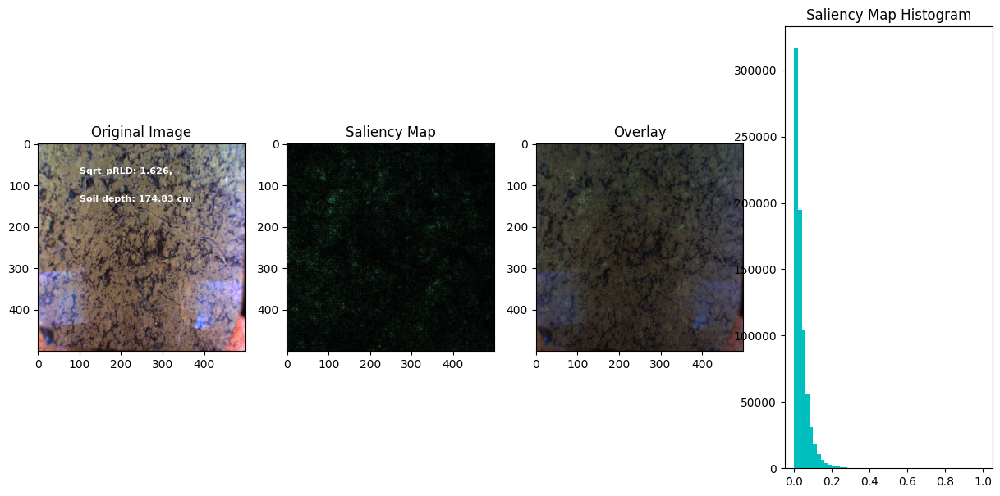

Processing Images:  10%|█         | 1/10 [00:02<00:26,  2.92s/it]

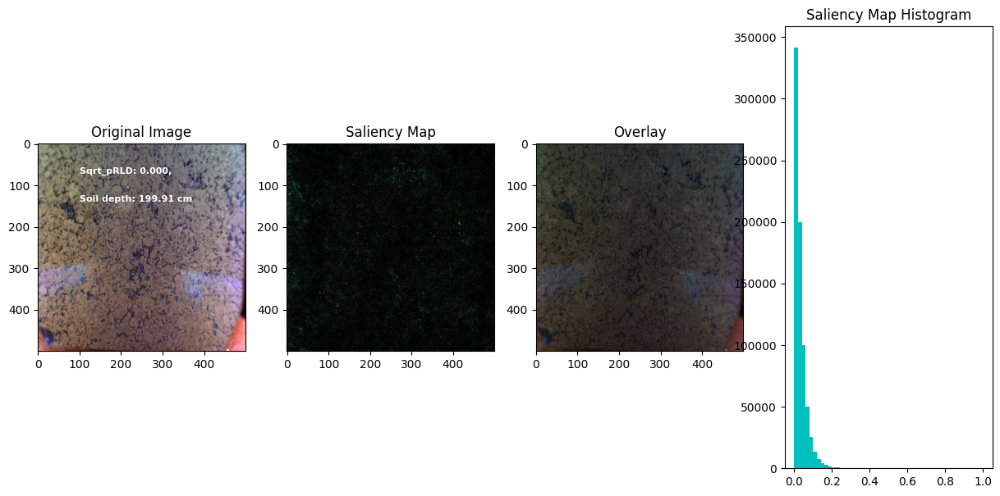

Processing Images:  20%|██        | 2/10 [00:06<00:24,  3.05s/it]

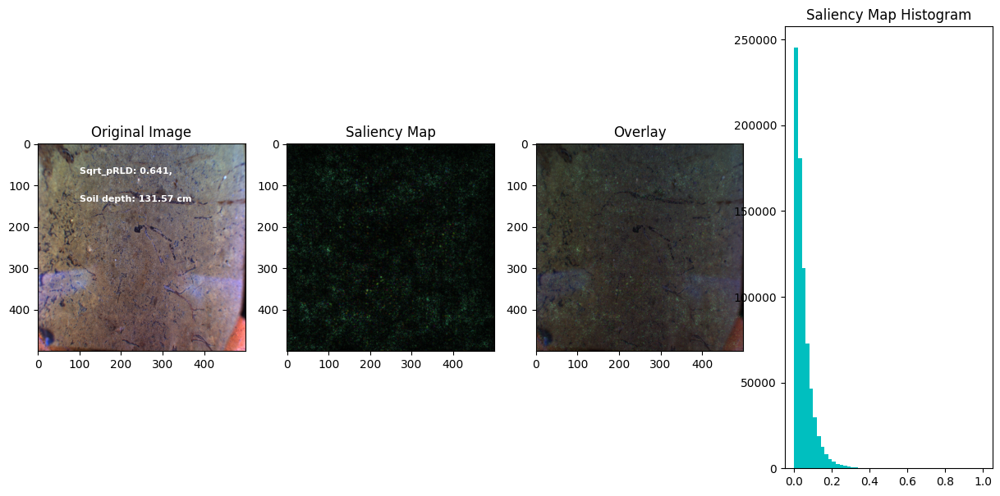

Processing Images:  30%|███       | 3/10 [00:09<00:21,  3.01s/it]

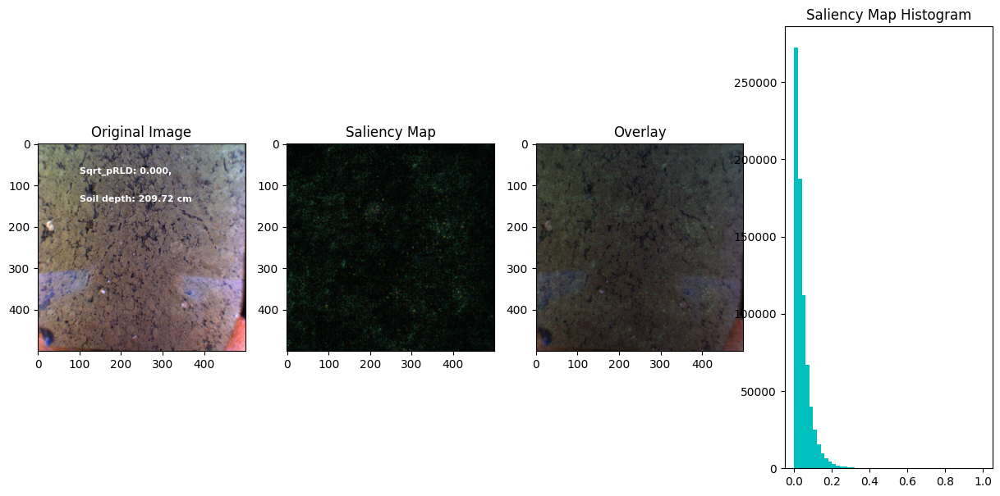

Processing Images:  40%|████      | 4/10 [00:11<00:17,  2.96s/it]

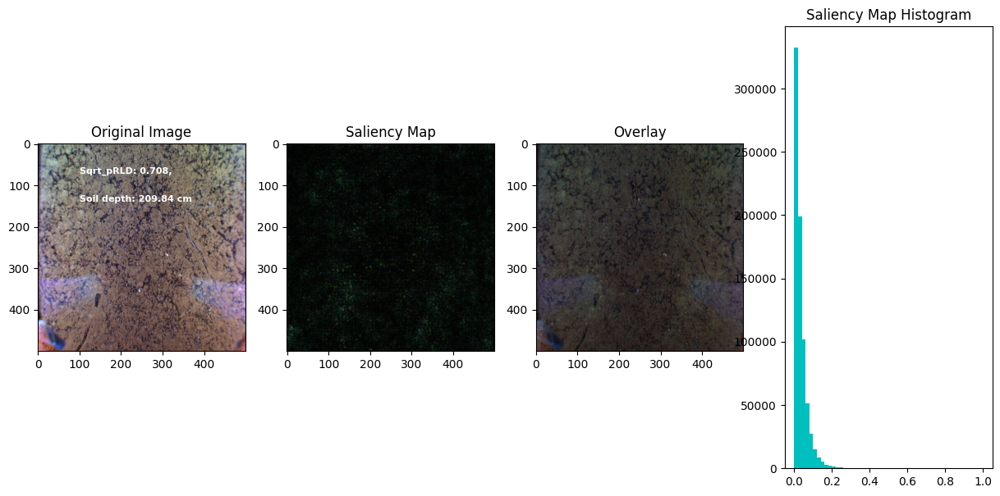

Processing Images:  50%|█████     | 5/10 [00:14<00:14,  2.93s/it]

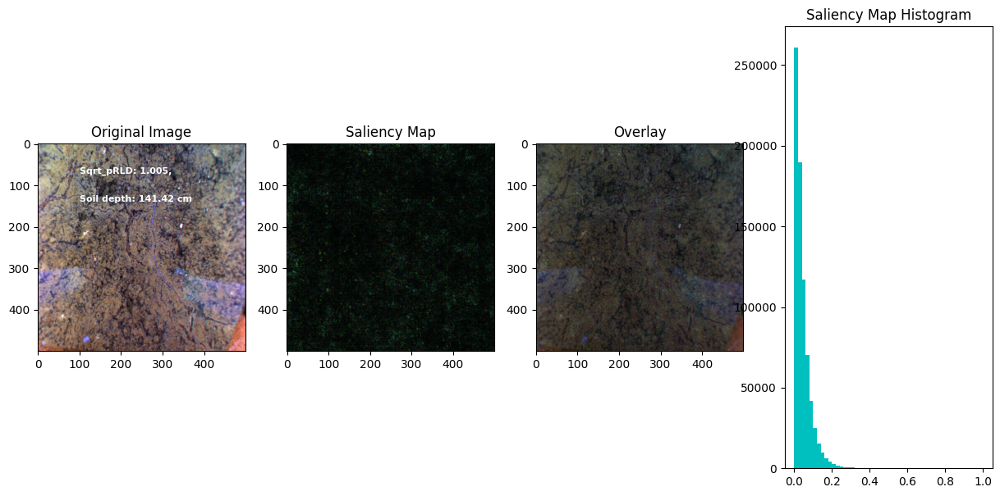

Processing Images:  60%|██████    | 6/10 [00:18<00:12,  3.13s/it]

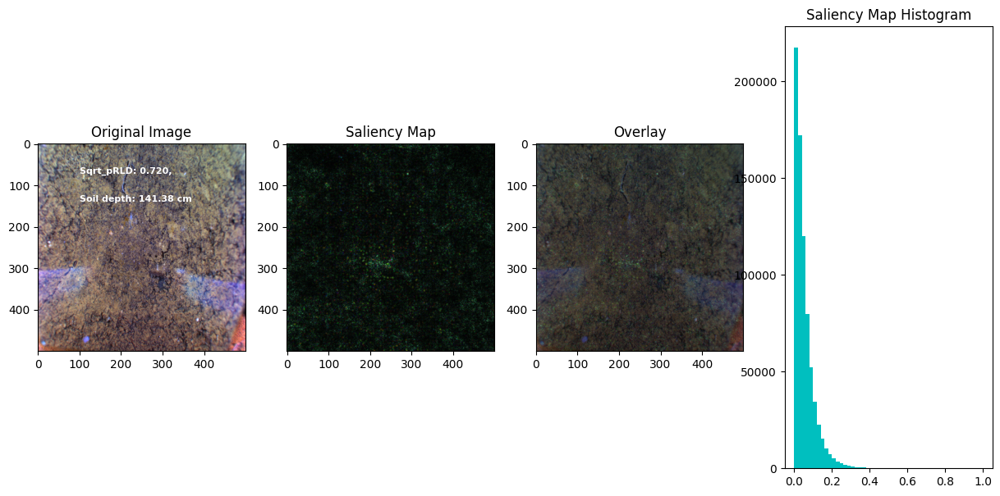

Processing Images:  70%|███████   | 7/10 [00:21<00:09,  3.09s/it]

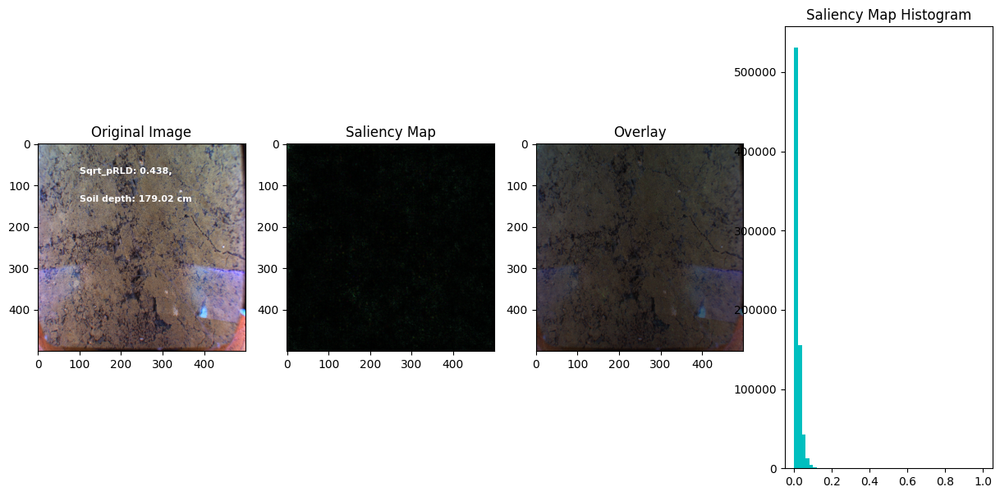

Processing Images:  80%|████████  | 8/10 [00:24<00:06,  3.02s/it]

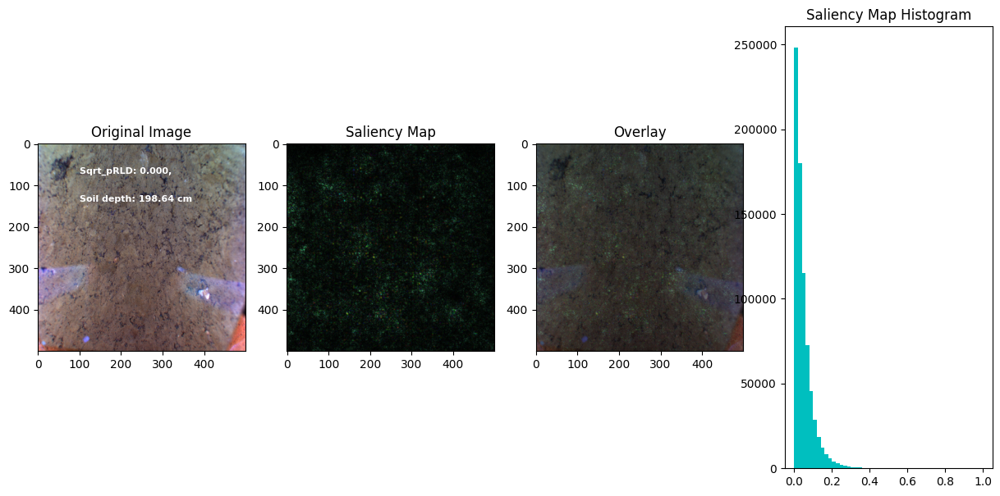

Processing Images:  90%|█████████ | 9/10 [00:27<00:02,  3.00s/it]

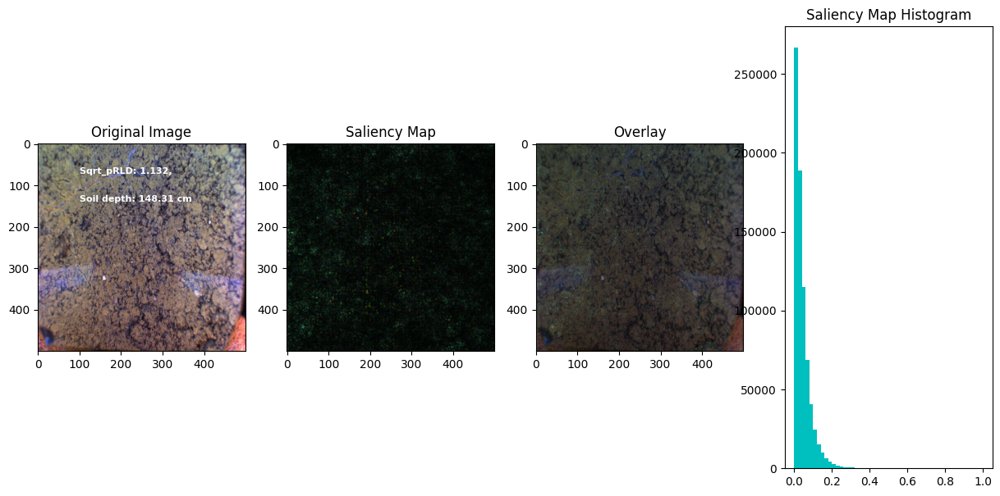

Processing Images: 100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


In [51]:
import tensorflow as tf
import cv2
import numpy as np
from tensorflow.keras.preprocessing import image
from tqdm import tqdm
import matplotlib.pyplot as plt

def get_saliency_map(model, img_array):
    # Ensure eager execution is enabled
    tf.config.run_functions_eagerly(True)

    # Convert NumPy array to TensorFlow tensor
    img_array_tf = tf.convert_to_tensor(img_array, dtype=tf.float32)

    # Create a GradientTape to record the operations
    with tf.GradientTape() as tape:
        # Watch the input image
        tape.watch(img_array_tf)

        # Get the model prediction
        prediction = model(img_array_tf)

    # Calculate gradients of the model's output with respect to the input image
    grads = tape.gradient(prediction, img_array_tf)

    # Check if gradients are available
    if grads is None:
        raise ValueError("Gradient calculation failed. Check model architecture.")

    # Calculate the saliency map by taking the absolute gradients
    saliency_map = tf.abs(grads)[0]

    # Normalize the saliency map
    saliency_map /= tf.reduce_max(saliency_map)

    # Disable eager execution
    tf.config.run_functions_eagerly(False)

    return saliency_map.numpy()

# Visualize saliency maps for a few images
for index, row in tqdm(df.sample(10).iterrows(), total=len(df.sample(10)), desc="Processing Images"):
    img_path = row['id']
    img = image.load_img(img_path, target_size=(500, 500))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0

    # Generate Saliency Map
    
    saliency_map = get_saliency_map(loaded_model, img_array)

   
    img = image.img_to_array(img)
    saliency_map = cv2.resize(saliency_map, (img.shape[1], img.shape[0]))

    # Plot the original image, saliency map, overlay, and histogram
    plt.figure(figsize=(15, 7))

    plt.subplot(1, 4, 1)
    plt.imshow(img.astype('uint8'))
    plt.title('Original Image')
    plt.text(100, 140, f'Sqrt_pRLD: {row["pRLD"]:.3f}, \n\n\nSoil depth: {row["soil_depth"]:.2f} cm', color='white', fontsize=8, fontweight='bold')


    plt.subplot(1, 4, 2)
    plt.imshow(saliency_map, cmap='gray')  
    plt.title('Saliency Map')

    plt.subplot(1, 4, 3)
    plt.imshow(img.astype('uint8'))
    plt.imshow(saliency_map, cmap='hot', alpha=0.6)  
    plt.title('Overlay')

    plt.subplot(1, 4, 4)
    plt.hist(saliency_map.flatten(), bins=50, color='c')
    plt.title('Saliency Map Histogram')

    plt.show()
    


In [52]:
import matplotlib.backends.backend_pdf as pdf_pages

# Create a PDF file to save the images
pdf_filename = 'saliency_maps.pdf'
pdf_pages_obj = pdf_pages.PdfPages(pdf_filename)

# Visualize saliency maps for a few images
for index, row in tqdm(df.sample(10).iterrows(), total=len(df.sample(10)), desc="Processing Images"):
    img_path = row['id']
    img = image.load_img(img_path, target_size=(500, 500))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0

    # Generate Saliency Map
    saliency_map = get_saliency_map(loaded_model, img_array)

    img = image.img_to_array(img)
    saliency_map = cv2.resize(saliency_map, (img.shape[1], img.shape[0]))

    # Plot the original image, saliency map, overlay, and histogram
    plt.figure(figsize=(15, 7))

    plt.subplot(1, 4, 1)
    plt.imshow(img.astype('uint8'))
    plt.title('Original Image')
    plt.text(100, 140, f'Sqrt_pRLD: {row["pRLD"]:.3f}, \n\n\nSoil depth: {row["soil_depth"]:.2f} cm', color='white', fontsize=8, fontweight='bold')

    plt.subplot(1, 4, 2)
    plt.imshow(saliency_map, cmap='gray')  
    plt.title('Saliency Map')

    plt.subplot(1, 4, 3)
    plt.imshow(img.astype('uint8'))
    plt.imshow(saliency_map, cmap='hot', alpha=0.6)  
    plt.title('Overlay')

    plt.subplot(1, 4, 4)
    plt.hist(saliency_map.flatten(), bins=50, color='c')
    plt.title('Saliency Map Histogram')

    # Save the current figure to the PDF file
    pdf_pages_obj.savefig()

    # Close the current figure to free up resources
    plt.close()

# Close the PDF file
pdf_pages_obj.close()

Processing Images: 100%|██████████| 10/10 [00:25<00:00,  2.57s/it]


In [67]:
df

,id,Isotope,pRLD,tube_depth,tube,soil_depth
0,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.075728,0.000000,4354,221,213.867884
1,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.104105,1.540048,2781,120,151.144655
2,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.612283,1.800970,2922,208,156.767017
3,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.439682,0.187925,4392,149,215.383130
4,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.813973,0.000000,3621,30,184.639577
...,...,...,...,...,...,...
21284,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.947481,1.966258,3518,135,180.532462
21285,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.310124,0.000000,4110,256,204.138406
21286,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.939216,0.295568,4111,148,204.178281
21287,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-28.378896,0.595834,2431,95,137.188438


In [78]:
df.loc[(df['tube_depth'] == 2535) & (df['tube'] == 244)].index


Int64Index([18653], dtype='int64')

In [79]:
index_for_tube_depth_2430 = df.loc[(df['tube_depth'] == 2535) & (df['tube'] == 244)].index

index=index_for_tube_depth_2430[0]
index

18653

In [88]:
index_for_tube_depth_2430 = df.loc[(df['tube_depth'] == 2888) & (df['tube'] == 124)].index

index1=index_for_tube_depth_2430[0]
index1

21288

In [91]:
df.reset_index(inplace=True)

In [92]:
df

,index,id,Isotope,pRLD,tube_depth,tube,soil_depth
0,0,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.075728,0.000000,4354,221,213.867884
1,1,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.104105,1.540048,2781,120,151.144655
2,2,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.612283,1.800970,2922,208,156.767017
3,3,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.439682,0.187925,4392,149,215.383130
4,4,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.813973,0.000000,3621,30,184.639577
...,...,...,...,...,...,...,...
20687,21284,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.947481,1.966258,3518,135,180.532462
20688,21285,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.310124,0.000000,4110,256,204.138406
20689,21286,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.939216,0.295568,4111,148,204.178281
20690,21287,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-28.378896,0.595834,2431,95,137.188438


In [96]:
index_for_tube_depth_2430 = df.loc[(df['tube_depth'] == 2535) & (df['tube'] == 244)].index

index1=index_for_tube_depth_2430[0]
index1

18128

In [152]:
df[df['pRLD'] < .6]

,index,id,Isotope,pRLD,tube_depth,tube,soil_depth
0,0,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.075728,0.000000,4354,221,213.867884
3,3,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.439682,0.187925,4392,149,215.383130
4,4,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.813973,0.000000,3621,30,184.639577
7,7,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.214981,0.000000,3902,196,195.844426
10,10,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.529008,0.000000,3726,169,188.826442
...,...,...,...,...,...,...,...
20685,21281,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.060385,0.000000,3586,202,183.243955
20688,21285,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.310124,0.000000,4110,256,204.138406
20689,21286,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.939216,0.295568,4111,148,204.178281
20690,21287,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-28.378896,0.595834,2431,95,137.188438


In [153]:

index1=3
df.iloc[index1][1]

'/home/trl102/Dir/FullDataJune2018/Wheat4/Radimax_Cam2_PipeID_149_Position_4392_TS_2018-06-18 16.57.42.739B.jpg'

Processing Images:   0%|          | 0/1 [00:00<?, ?it/s]

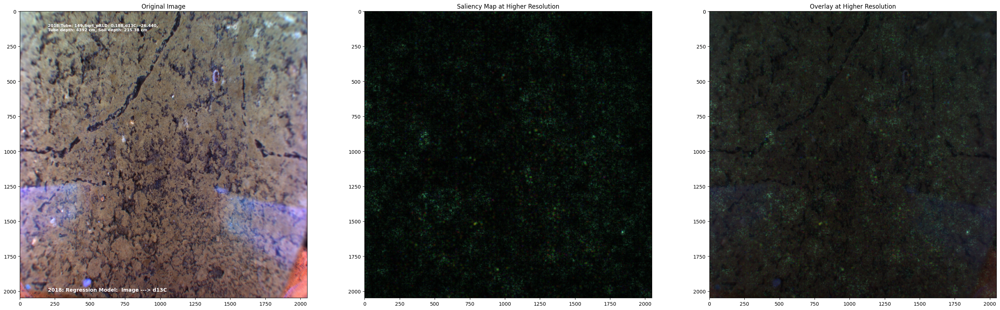

Processing Images: 100%|██████████| 1/1 [00:07<00:00,  7.65s/it]


In [154]:
import tensorflow as tf
import cv2
import numpy as np
from tensorflow.keras.preprocessing import image
from tqdm import tqdm
import matplotlib.pyplot as plt

def get_saliency_map_upsample(model, img_path, original_size=(2048, 2048), model_input_size=(500, 500)):
    # Load the original image at higher resolution
    original_img = image.load_img(img_path, target_size=original_size)
    
    # Convert the image to a NumPy array
    img_array_high_res = image.img_to_array(original_img)
    
    # Resize the image array to match the model's input size
    img_array = cv2.resize(img_array_high_res, model_input_size)
    
    # Expand dimensions and normalize
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0

    # Ensure eager execution is enabled
    tf.config.run_functions_eagerly(True)

    # Convert NumPy array to TensorFlow tensor
    img_array_tf = tf.convert_to_tensor(img_array, dtype=tf.float32)

    # Create a GradientTape to record the operations
    with tf.GradientTape() as tape:
        # Watch the input image
        tape.watch(img_array_tf)

        # Get the model prediction
        prediction = model(img_array_tf)

    # Calculate gradients of the model's output with respect to the input image
    grads = tape.gradient(prediction, img_array_tf)

    # Check if gradients are available
    if grads is None:
        raise ValueError("Gradient calculation failed. Check model architecture.")

    # Calculate the saliency map by taking the absolute gradients
    saliency_map = tf.abs(grads)[0]

    # Normalize the saliency map
    saliency_map /= tf.reduce_max(saliency_map)

    # Resize the saliency map to the original image size
    saliency_map_upsampled = cv2.resize(saliency_map.numpy(), original_size)

    # Disable eager execution
    tf.config.run_functions_eagerly(False)

    return saliency_map_upsampled

# Visualize saliency maps for a few images
for index, row in tqdm(df.sample(1).iterrows(), total=len(df.sample(1)), desc="Processing Images"):
    
    img_path = df.iloc[index1][1]
    #img_path = row['id']
    
    # Generate Saliency Map at higher resolution
    saliency_map_original_size = get_saliency_map_upsample(loaded_model, img_path, original_size=(2048, 2048), model_input_size=(500, 500))

    # Visualize the results
    plt.figure(figsize=(35, 15))

    plt.subplot(1, 3, 1)
    plt.imshow(image.load_img(img_path, target_size=(2048, 2048)))
    plt.title('Original Image')
    Tube=df.iloc[index1]['tube']
    Sqrt_pRLD=df.iloc[index1]['pRLD']
    d13C=df.iloc[index1]["Isotope"]
    Tube_depth=df.iloc[index1]["tube_depth"]
    Soil_depth=df.iloc[index1]["soil_depth"]
    
    plt.text(200, 140, f'\n2018:Tube: {Tube},Sqrt_pRLD: {Sqrt_pRLD:.3f},d13C: {d13C:.3f}, \nTube depth: {Tube_depth} cm, Soil depth: {Soil_depth:.2f} cm', color='white', fontsize=8, fontweight='bold')
    plt.text(200, 2000, f'2018: Regression Model:  Image ---> d13C',color='white', fontsize=10, fontweight='bold')

    plt.subplot(1, 3, 2)
    plt.imshow(saliency_map_original_size, cmap='gray')
    plt.title('Saliency Map at Higher Resolution')

    plt.subplot(1, 3, 3)
    plt.imshow(image.load_img(img_path, target_size=(2048, 2048)))
    plt.imshow(saliency_map_original_size, cmap='hot', alpha=0.8)
    plt.title('Overlay at Higher Resolution')

    plt.show()



In [112]:
df.iloc[index1]['tube']

244

Text(200, 2000, '2018: Regression Model:  Image ---> d13C')

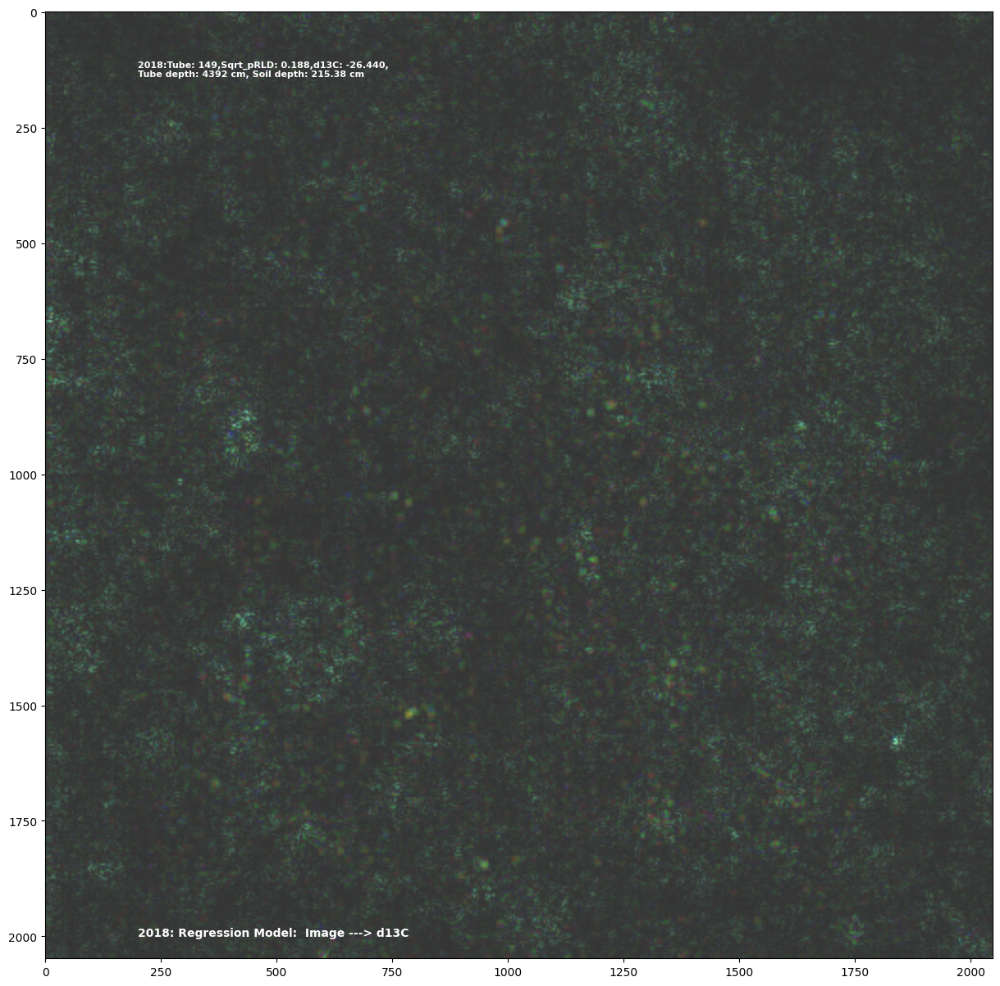

In [155]:

plt.figure(figsize=(15, 15))  # Adjust the width and height as needed
plt.imshow(saliency_map_original_size, cmap='gray', alpha=0.8)
Tube=df.iloc[index1]['tube']
Sqrt_pRLD=df.iloc[index1]['pRLD']
d13C=df.iloc[index1]["Isotope"]
Tube_depth=df.iloc[index1]["tube_depth"]
Soil_depth=df.iloc[index1]["soil_depth"]

plt.text(200, 140, f'\n2018:Tube: {Tube},Sqrt_pRLD: {Sqrt_pRLD:.3f},d13C: {d13C:.3f}, \nTube depth: {Tube_depth} cm, Soil depth: {Soil_depth:.2f} cm', color='white', fontsize=8, fontweight='bold')
plt.text(200, 2000, f'2018: Regression Model:  Image ---> d13C',color='white', fontsize=10, fontweight='bold')


Text(200, 2000, '2018: Regression Model:  Image ---> d13C')

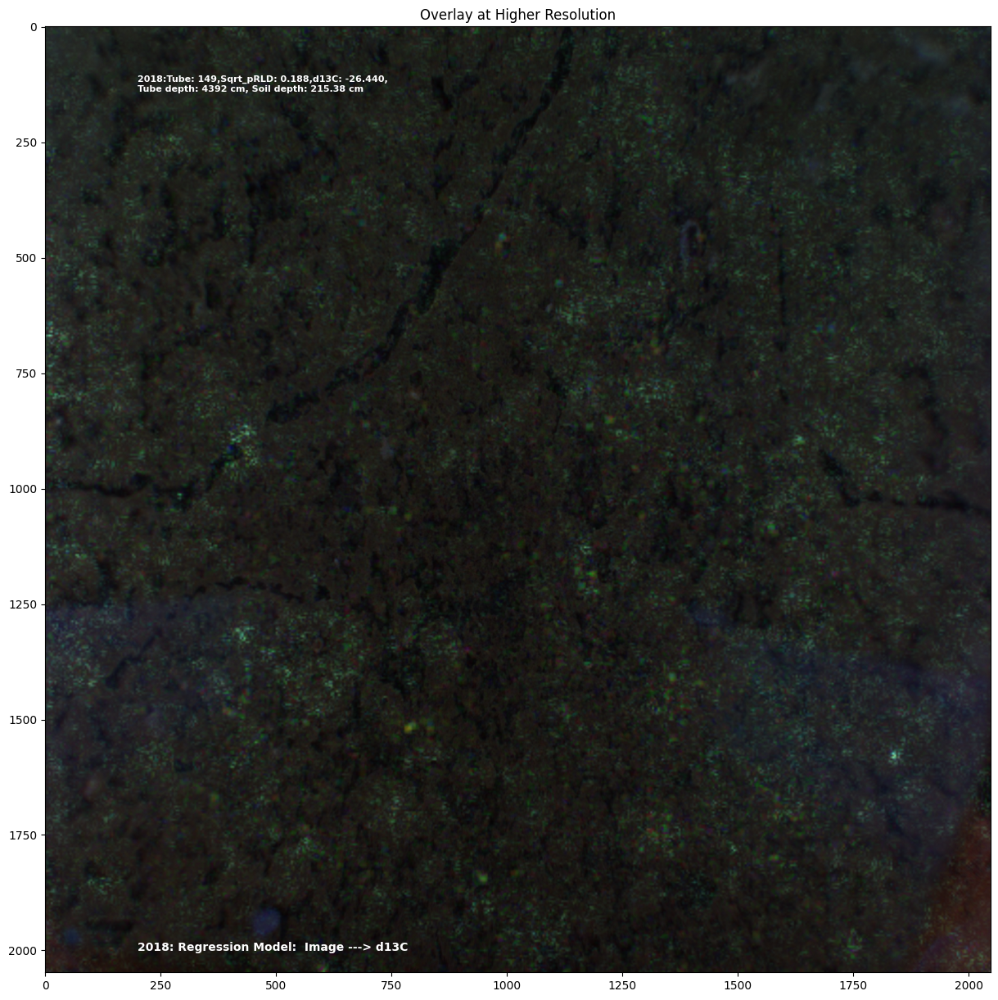

In [156]:
plt.figure(figsize=(15, 15))  # Adjust the width and height as needed

plt.imshow(image.load_img(img_path, target_size=(2048, 2048)))
plt.imshow(saliency_map_original_size, cmap='hot', alpha=0.8)
plt.title('Overlay at Higher Resolution')
Tube=df.iloc[index1]['tube']
Sqrt_pRLD=df.iloc[index1]['pRLD']
d13C=df.iloc[index1]["Isotope"]
Tube_depth=df.iloc[index1]["tube_depth"]
Soil_depth=df.iloc[index1]["soil_depth"]

plt.text(200, 140, f'\n2018:Tube: {Tube},Sqrt_pRLD: {Sqrt_pRLD:.3f},d13C: {d13C:.3f}, \nTube depth: {Tube_depth} cm, Soil depth: {Soil_depth:.2f} cm', color='white', fontsize=8, fontweight='bold')
plt.text(200, 2000, f'2018: Regression Model:  Image ---> d13C',color='white', fontsize=10, fontweight='bold')


In [159]:
cd MyDailyWork/DL2019/

/home/trl102/Dir/MyDailyWork/DL2019


In [233]:
df=pd.read_csv("Data_May_June_2019.csv").drop('Unnamed: 0',axis=1)
#df.rename(columns={'Delta13C': 'Isotope'}, inplace=True)

print(df.shape)
df['soil_depth']= (((df['tube_depth']-420)*np.sin((23.5*(np.pi/180)))+570))/10.0 # in cm
#df=df[(df['soil_depth']>140) & (df['soil_depth']<190)]
df.dropna(inplace=True)
print(df.shape)

(60151, 6)
(60151, 7)


In [226]:
from keras import backend as K
from tensorflow.keras.models import load_model

def r_square(y_true, y_pred):
    SS_res = K.sum(K.square(y_true - y_pred))
    SS_tot = K.sum(K.square(y_true - K.mean(y_true)))
    return 1 - SS_res / (SS_tot + K.epsilon())

# Define custom_objects dictionary with the custom metric
custom_objects = {'r_square': r_square}

# Load the model with custom_objects\
loaded_model = load_model('best_model_weights_architecture_May_June_2019_pRLD_pred.h5', custom_objects=custom_objects)

In [183]:
df18

,id,Isotope,pRLD,tube_depth,tube,soil_depth
0,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.075728,0.000000,4354,221,213.867884
1,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.104105,1.540048,2781,120,151.144655
2,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.612283,1.800970,2922,208,156.767017
3,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.439682,0.187925,4392,149,215.383130
4,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.813973,0.000000,3621,30,184.639577
...,...,...,...,...,...,...
21284,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.947481,1.966258,3518,135,180.532462
21285,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.310124,0.000000,4110,256,204.138406
21286,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.939216,0.295568,4111,148,204.178281
21287,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-28.378896,0.595834,2431,95,137.188438


In [201]:
df

,id,Delta13C,pRLD,tube_depth,tube,soil_depth
0,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.075728,0.000000,4354,221,213.867884
1,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.104105,1.540048,2781,120,151.144655
2,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.612283,1.800970,2922,208,156.767017
3,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.439682,0.187925,4392,149,215.383130
4,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-25.813973,0.000000,3621,30,184.639577
...,...,...,...,...,...,...
21284,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.947481,1.966258,3518,135,180.532462
21285,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.310124,0.000000,4110,256,204.138406
21286,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.939216,0.295568,4111,148,204.178281
21287,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-28.378896,0.595834,2431,95,137.188438


In [202]:
df.reset_index(inplace=True)

In [235]:
df[df['pRLD'] > 0.6]

,id,LogDelta15N,Delta13C,pRLD,tube_depth,tube,soil_depth
1147,/home/trl102/Dir/Wheat8_13-05-2019/Radimax_Cam...,1.243261,-28.138296,0.618263,2091,170,123.630969
1441,/home/trl102/Dir/Wheat8_13-05-2019/Radimax_Cam...,1.243261,-28.138296,0.613207,1146,170,85.949182
1759,/home/trl102/Dir/Wheat8_13-05-2019/Radimax_Cam...,1.312718,-27.770384,0.612372,1702,158,108.119631
1838,/home/trl102/Dir/Wheat8_13-05-2019/Radimax_Cam...,1.158626,-27.451786,0.615702,1671,212,106.883509
2516,/home/trl102/Dir/Wheat8_13-05-2019/Radimax_Cam...,1.387775,-28.189163,0.701896,2196,226,127.817835
...,...,...,...,...,...,...,...
56246,/home/trl102/Dir/Wheat9_20-06-2019/Radimax_Cam...,1.286176,-28.070195,0.603583,3258,164,170.164986
56292,/home/trl102/Dir/Wheat9_20-06-2019/Radimax_Cam...,1.169928,-28.130384,0.619689,2592,159,143.608298
56582,/home/trl102/Dir/Wheat9_20-06-2019/Radimax_Cam...,1.090971,-28.375463,0.666721,2521,199,140.777179
58517,/home/trl102/Dir/Wheat9_20-06-2019/Radimax_Cam...,1.293170,-27.915792,0.695712,2660,234,146.319791


In [191]:
 df.rename(columns={'Isotope': 'Delta13C'},inplace=True)


In [221]:
df[df['pRLD'] > 2.5]

,index,id,Delta13C,pRLD,tube_depth,tube,soil_depth
190,195,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.095064,2.616434,2534,38,141.295553
2419,2492,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-24.749747,2.623174,2361,22,134.397194
2896,2978,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.096169,2.528279,2082,142,123.272095
3331,3430,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.369701,2.550603,2676,285,146.957790
3976,4097,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.700385,3.077077,2534,118,141.295553
6342,6535,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.889373,2.506126,2887,228,155.371395
7462,7689,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.573996,2.632369,2710,117,148.313537
7642,7874,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.454582,2.646805,2430,234,137.148563
8155,8403,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-26.219034,2.528646,2219,210,128.734957
9582,9873,/home/trl102/Dir/FullDataJune2018/Wheat4/Radim...,-27.817468,2.646454,2080,128,123.192345


In [241]:
index1=56582	
df.iloc[index1]['id']

'/home/trl102/Dir/Wheat9_20-06-2019/Radimax_Cam1_PipeID_199_Position_2521_TS_2019-06-24 15.37.44.120.jpg'

Processing Images:   0%|          | 0/1 [00:00<?, ?it/s]

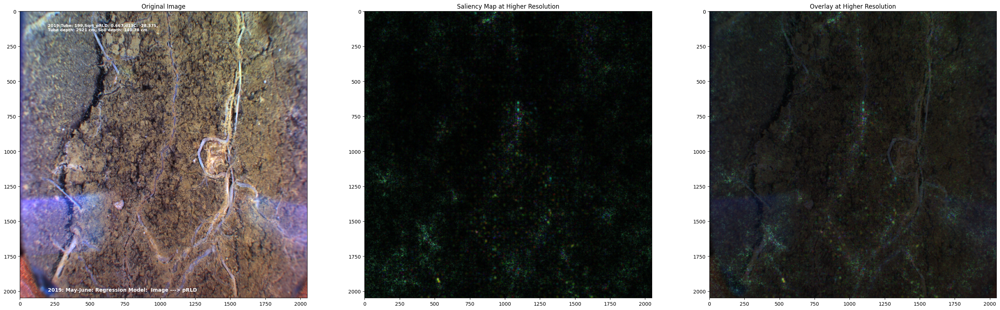

Processing Images: 100%|██████████| 1/1 [00:06<00:00,  6.95s/it]


In [242]:
import tensorflow as tf
import cv2
import numpy as np
from tensorflow.keras.preprocessing import image
from tqdm import tqdm
import matplotlib.pyplot as plt

def get_saliency_map_upsample(model, img_path, original_size=(2048, 2048), model_input_size=(500, 500)):
    # Load the original image at higher resolution
    original_img = image.load_img(img_path, target_size=original_size)
    
    # Convert the image to a NumPy array
    img_array_high_res = image.img_to_array(original_img)
    
    # Resize the image array to match the model's input size
    img_array = cv2.resize(img_array_high_res, model_input_size)
    
    # Expand dimensions and normalize
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0

    # Ensure eager execution is enabled
    tf.config.run_functions_eagerly(True)

    # Convert NumPy array to TensorFlow tensor
    img_array_tf = tf.convert_to_tensor(img_array, dtype=tf.float32)

    # Create a GradientTape to record the operations
    with tf.GradientTape() as tape:
        # Watch the input image
        tape.watch(img_array_tf)

        # Get the model prediction
        prediction = model(img_array_tf)

    # Calculate gradients of the model's output with respect to the input image
    grads = tape.gradient(prediction, img_array_tf)

    # Check if gradients are available
    if grads is None:
        raise ValueError("Gradient calculation failed. Check model architecture.")

    # Calculate the saliency map by taking the absolute gradients
    saliency_map = tf.abs(grads)[0]

    # Normalize the saliency map
    saliency_map /= tf.reduce_max(saliency_map)

    # Resize the saliency map to the original image size
    saliency_map_upsampled = cv2.resize(saliency_map.numpy(), original_size)

    # Disable eager execution
    tf.config.run_functions_eagerly(False)

    return saliency_map_upsampled

# Visualize saliency maps for a few images
for index, row in tqdm(df.sample(1).iterrows(), total=len(df.sample(1)), desc="Processing Images"):
    
    img_path = df.iloc[index1]['id']
    #img_path = row['id']
    
    # Generate Saliency Map at higher resolution
    saliency_map_original_size = get_saliency_map_upsample(loaded_model, img_path, original_size=(2048, 2048), model_input_size=(500, 500))

    # Visualize the results
    plt.figure(figsize=(35, 15))

    plt.subplot(1, 3, 1)
    plt.imshow(image.load_img(img_path, target_size=(2048, 2048)))
    plt.title('Original Image')
    Tube=df.iloc[index1]['tube']
    Sqrt_pRLD=df.iloc[index1]['pRLD']
    d13C=df.iloc[index1]["Delta13C"]
    Tube_depth=df.iloc[index1]["tube_depth"]
    Soil_depth=df.iloc[index1]["soil_depth"]
    
    plt.text(200, 140, f'\n2019:Tube: {Tube},Sqrt_pRLD: {Sqrt_pRLD:.3f},d13C: {d13C:.3f}, \nTube depth: {Tube_depth} cm, Soil depth: {Soil_depth:.2f} cm', color='white', fontsize=8, fontweight='bold')
    plt.text(200, 2000, f'2019: May-June: Regression Model:  Image ---> pRLD',color='white', fontsize=10, fontweight='bold')

    plt.subplot(1, 3, 2)
    plt.imshow(saliency_map_original_size, cmap='gray')
    plt.title('Saliency Map at Higher Resolution')

    plt.subplot(1, 3, 3)
    plt.imshow(image.load_img(img_path, target_size=(2048, 2048)))
    plt.imshow(saliency_map_original_size, cmap='hot', alpha=0.8)
    plt.title('Overlay at Higher Resolution')

    plt.show()

Text(200, 2000, '2019: May-June: Regression Model:  Image ---> pRLD')

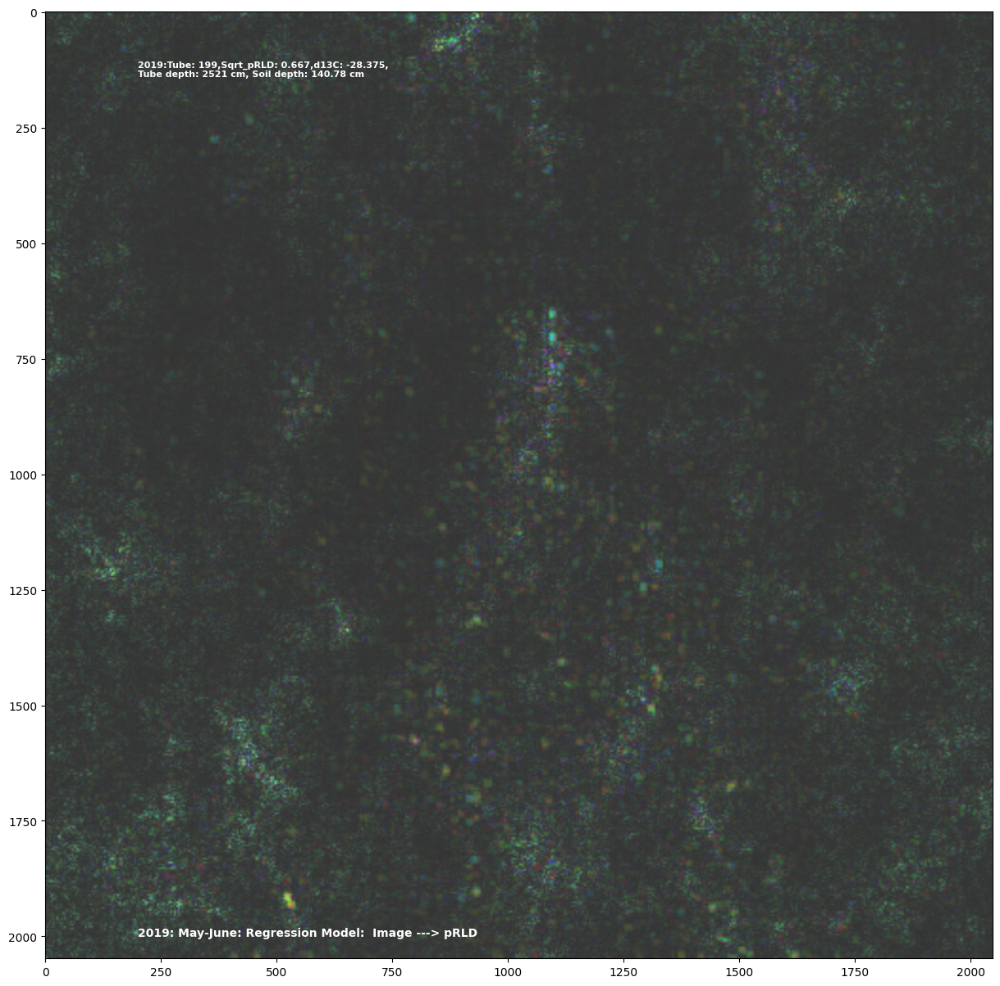

In [243]:

plt.figure(figsize=(15, 15))  # Adjust the width and height as needed
plt.imshow(saliency_map_original_size, cmap='gray', alpha=0.8)
Tube=df.iloc[index1]['tube']
Sqrt_pRLD=df.iloc[index1]['pRLD']
d13C=df.iloc[index1]["Delta13C"]
Tube_depth=df.iloc[index1]["tube_depth"]
Soil_depth=df.iloc[index1]["soil_depth"]

plt.text(200, 140, f'\n2019:Tube: {Tube},Sqrt_pRLD: {Sqrt_pRLD:.3f},d13C: {d13C:.3f}, \nTube depth: {Tube_depth} cm, Soil depth: {Soil_depth:.2f} cm', color='white', fontsize=8, fontweight='bold')
plt.text(200, 2000, f'2019: May-June: Regression Model:  Image ---> pRLD',color='white', fontsize=10, fontweight='bold')

Text(200, 2000, '2019: May-June: Regression Model:  Image ---> pRLD')

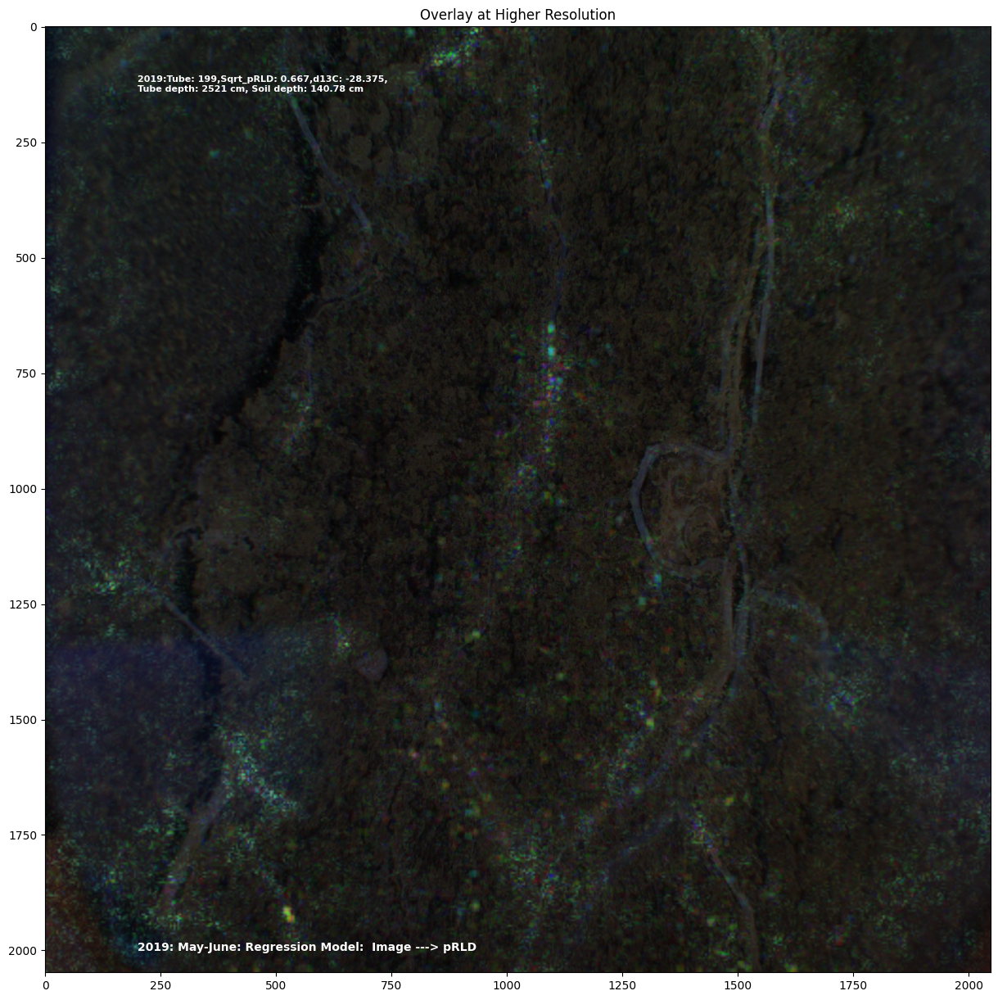

In [244]:
plt.figure(figsize=(15, 15))  # Adjust the width and height as needed

plt.imshow(image.load_img(img_path, target_size=(2048, 2048)))
plt.imshow(saliency_map_original_size, cmap='hot', alpha=0.8)
plt.title('Overlay at Higher Resolution')
Tube=df.iloc[index1]['tube']
Sqrt_pRLD=df.iloc[index1]['pRLD']
d13C=df.iloc[index1]["Delta13C"]
Tube_depth=df.iloc[index1]["tube_depth"]
Soil_depth=df.iloc[index1]["soil_depth"]

plt.text(200, 140, f'\n2019:Tube: {Tube},Sqrt_pRLD: {Sqrt_pRLD:.3f},d13C: {d13C:.3f}, \nTube depth: {Tube_depth} cm, Soil depth: {Soil_depth:.2f} cm', color='white', fontsize=8, fontweight='bold')
plt.text(200, 2000, f'2019: May-June: Regression Model:  Image ---> pRLD',color='white', fontsize=10, fontweight='bold')